In [1]:
import matplotlib.pyplot as plt
import numpy as np
import scipy
import os
import pandas as pd
import pickle
import cmcrameri.cm as cmc

In [2]:
def get_scardec_stf(scardec_name, wanted_type = 'fctopt'):
    time = []
    momentrate = []

    event = os.listdir(f'/home/earthquakes1/homes/Rebecca/phd/stf/data/scardec/{scardec_name}')
    starts = [n for n, l in enumerate(event) if l.startswith(wanted_type)]
    with open(f'/home/earthquakes1/homes/Rebecca/phd/stf/data/scardec/{scardec_name}/{event[starts[0]]}') as f:
        lines = f.read().splitlines()

    lines = lines[2:]
    for line in lines:
        split = line.split(' ')
        split = [s for s in split if s not in ['', ' ', '\n']]
        time.append(float(split[0]))
        momentrate.append(float(split[1]))

    momentrate = np.array(momentrate)
    time = np.array(time)
    return momentrate, time

In [3]:
def get_ye_stf(ye_name):
    data_path = '/home/earthquakes1/homes/Rebecca/phd/stf/data/Ye_et_al_2016/'
    momentrate = []
    time = []

    with open(data_path + str(ye_name), 'r') as f:
        data = f.readlines()
        for line in data:
            line = line.strip()
            line = line.rstrip()
            if line[0] not in ['0','1','2','3','4','5','6','7','8','9']:
                continue
            line = line.split()
            time.append(float(line[0]))
            momentrate.append(float(line[1]))
    momentrate = np.array(momentrate)
    time = np.array(time)
    return momentrate, time

In [4]:
def get_usgs_stf(usgs_name):
    data_path = '/home/earthquakes1/homes/Rebecca/phd/stf/data/USGS/'
    momentrate = []
    time = []

    with open(data_path + str(usgs_name), 'r') as f:
        data = f.readlines()
        for line in data:
            line = line.strip()
            line = line.rstrip()
            if line[0] not in ['0','1','2','3','4','5','6','7','8','9']:
                continue
            line = line.split()
            time.append(float(line[0]))
            momentrate.append(float(line[1]))

    momentrate = np.array(momentrate)
    time = np.array(time)

    momentrate = momentrate / 10**7 # convert to Nm from dyne cm
    return momentrate, time

In [5]:
def get_sigloch_stf(sigloch_name):
    data_path = '/home/siglochnas1/shared/AmplitudeProjects/pdata_processed/psdata_events/'
    momentrate = []
    time = []

    file_path = data_path + str(sigloch_name) + '/outfiles/ampinv.stf.xy'

    with open(file_path, 'r') as file:
        content = file.read()
        content = content.split('\n')
        greater_than_count = content.count('>')
        if greater_than_count > 0:
            time = [list(np.arange(0, 25.6, 0.1))]
            momentrate = [[]]
            for i in range(greater_than_count-1):
                time.append(list(np.arange(0, 25.6, 0.1)))
                momentrate.append([])


        stf_count = 0
        for c in content:
            if c not in ['<', '>', '']:
                split = c.split()
                #time[stf_count].append(float(split[0]))
                momentrate[stf_count].append(10**float(split[1]))
            else:
                stf_count += 1

    # time = np.arange(0, 25.6, 0.1)
    # time = np.array(time)
    return momentrate, time

In [6]:
def get_isc_stf(isc_name):
    isc_save_path = '/home/earthquakes1/homes/Rebecca/phd/stf/data/isc/'
    with open(f'{isc_save_path}{isc_name}/{isc_name}.txt', 'rb') as f:
        stf_list = pickle.load(f)
    with open(f'{isc_save_path}{isc_name}/{isc_name}_norm_info.txt', 'rb') as f:
        norm_dict = pickle.load(f)

    time = np.arange(0, 25.6, 0.1)
    momentrate = np.array(stf_list)*norm_dict['mo_norm']*10**8,
    #print(momentrate)
    return momentrate[0], time

In [7]:
combined = pd.read_csv('/home/earthquakes1/homes/Rebecca/phd/stf/data/combined_scardec_ye_usgs_sigloch_isc_mag.csv')

In [8]:
combined.columns = ['event', 'scardec', 'ye', 'isc', 'sigloch', 'usgs', 'mag']

In [9]:
def find_end_stf(momentrate, time, dataset = ''):
    not_zero = np.where(momentrate > 0)[0]
    #print(max(momentrate))
    start = min(not_zero)
    end = max(not_zero)

    detected_end = end
    detected_end_time = time[end]

    time = time[:end]
    momentrate = momentrate[:end]

    less_than_10 = np.where(momentrate <= 10*max(momentrate)/100)[0]

    if dataset == 'sigloch':
        start = np.where(momentrate > 0.05 * max(momentrate))[0][0]
    else:
        start = min(not_zero)
    #print(less_than_10)
    total_moment = scipy.integrate.simpson(momentrate[start:end],
                                        dx = time[1]-time[0])
    #print(less_than_10)
    for i in less_than_10:
        if i <= start:
            continue
        if i == 0:
            continue
        moment = scipy.integrate.simpson(momentrate[start:i],
                                        dx = time[1]-time[0])
        #print(i, moment/total_moment)
        if moment >= 0.5 * total_moment:
            #print('inif')
            #print(f'first time where < 10% of total momentrate and 50% of moment released: {time[i]} s')
            detected_end_time = time[i]
            detected_end = i
            #print(f'proportion of moment released: {(moment/total_moment)*100:.2f}%')
            break
    return detected_end_time, detected_end, time[start], start
    #return time[end], end

In [15]:
to_ignore = ['20051203_1610_1', '20071226_2204_2', '20030122_0206_1', '20090929_1748_0', '20120421_0125_1', '20110311_2011_2']

columns_to_save = ['event', 'dataset', 'mag', 'interp_momentrate']
df_interp = pd.DataFrame(columns = columns_to_save)
max_len = 0
peaks_dict = {}
count_datasets = {}

output_dir = '/home/earthquakes1/homes/Rebecca/phd/stf/figures/large_scale_peaks_all/'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

columns = ['event', 'scardec_opt_max_timing',  'scardec_moy_max_timing', 'ye_max_timing', 'usgs_max_timing', 'sigloch_0_max_timing', 'sigloch_1_max_timing', 'isc_max_timing']


for i, row in combined.iterrows():
	# if i < 360:
	# 	continue

	#fig, axs = plt.subplots(2, 1, figsize=(10, 10))

	event_dict = {}
	for dataset, get_stf in zip(['scardec_opt', 'scardec_moy', 'ye', 'usgs', 'sigloch', 'isc'], [get_scardec_stf, get_scardec_stf, get_ye_stf, get_usgs_stf, get_sigloch_stf, get_isc_stf]):

		if dataset == 'scardec_moy' or dataset == 'scardec_opt':
			name = row[dataset[:-4]]
		else:
			name = row[dataset]

		if name == '0' or name == 0:
			continue

		if dataset == 'scardec_moy':
			momentrate, time = get_stf(name, 'fctmoy')
		elif dataset == 'scardec_opt':
			momentrate, time = get_stf(name, 'fctopt')
		else:
			momentrate, time = get_stf(name)

		if dataset != 'sigloch':
			momentrate_list = [momentrate]
			time_list = [time]
		else:
			momentrate_list = momentrate
			time_list = time

		count = 0
		sigloch_count = 0
		for momentrate, time in zip(momentrate_list, time_list):
			if time[0] == time[1]:
				time = time[1:]

			if dataset != 'sigloch':
				save_key = row.event
				dataset_name = dataset
			else:
				dataset_name = dataset + '_' + str(count)
				save_key = row.event + '_' + str(count)

			if save_key in to_ignore:
				continue
			#print(time[0:10])
			
			momentrate = np.array(momentrate)

			if dataset == 'sigloch':
				#momentrate = 10**momentrate
				#momentrate_sigloch = momentrate.copy()
				#file.write(f'Processing {dataset}_{sigloch_count}\n')
				name_to_save = f'{dataset}_{sigloch_count}'
				# print(name_to_save)
				# print(momentrate[0])
			else:
				#file.write(f'Processing {dataset}\n')
				name_to_save = dataset

			time = np.array(time)
			detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time, dataset)
			if dataset == 'sigloch':
				print(momentrate)
				print(row.event)
				print(detected_start_time, detected_start)
				print(detected_end_time, detected_end)
			time = time[detected_start:detected_end] # shift to start STF at zero
			time = time - time[0]
			momentrate = momentrate[detected_start:detected_end]
			max_len = max(max_len, len(momentrate))
			norm_momentrate = momentrate / max(momentrate)
			norm_time = time / max(time)
			#axs[0].plot(norm_time, norm_momentrate)

			interp_momentrate = np.interp(np.linspace(0, 1, 10000), norm_time, norm_momentrate)
			interp_momentrate[interp_momentrate < 0] = 0

			#axs[1].plot(np.linspace(0, 1, 100), interp_momentrate)

			df_interp = pd.concat([df_interp, pd.DataFrame([[row.event, dataset_name, row.mag, interp_momentrate]], columns = columns_to_save)], ignore_index = True)
			count += 1

			peak_timing = np.argmax(interp_momentrate)

			event_dict[name_to_save + '_max_timing'] = peak_timing

			#peaks_plot_overall(momentrate, momentrate_unsmoothed, time, peaks, row.event, name_to_save)
			#print(f'{dataset} peaks: {num_peaks}')
			if dataset == 'sigloch' and sigloch_count > 0:
				print('sigloch_1')


			sigloch_count += 1
	peaks_dict[row.event] = event_dict
	#print(peaks_dict.keys())
	if i % 100 == 0:
		print('Writing to file: ', i)
		df = pd.DataFrame.from_dict(peaks_dict, orient='index', columns=columns)
		print(df)
		df.to_csv(f'{output_dir}max_timing_unsmoothed_ave.csv', header=False, mode='a')
		peaks_dict = {}


print(count_datasets)
print('Writing to file: ', i)
df = pd.DataFrame.from_dict(peaks_dict, orient='index', columns=columns)
print(df)
df.to_csv(f'{output_dir}max_timing_unsmoothed_ave.csv', header=False, mode='a')
peaks_dict = {}
	#plt.show()
	#plt.close()
	# if i > 361:
	# 	break
	# 	break


/tmp/ipykernel_1178193/3194717986.py:97: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_interp = pd.concat([df_interp, pd.DataFrame([[row.event, dataset_name, row.mag, interp_momentrate]], columns = columns_to_save)], ignore_index = True)


Writing to file:  0
              event  scardec_opt_max_timing  scardec_moy_max_timing  \
20170818_0259   NaN                    9246                    9069   

              ye_max_timing usgs_max_timing sigloch_0_max_timing  \
20170818_0259           NaN             NaN                  NaN   

              sigloch_1_max_timing isc_max_timing  
20170818_0259                  NaN            NaN  
[2.79894136e+15 2.79895361e+15 3.51332398e+15 4.27446042e+15
 5.03958181e+15 5.75366935e+15 6.36268466e+15 6.81935187e+15
 7.09292389e+15 7.17554678e+15 7.08515572e+15 6.86546409e+15
 6.56540770e+15 6.23053156e+15 5.88548287e+15 5.53408468e+15
 5.16551706e+15 4.76709822e+15 4.33634772e+15 3.88153584e+15
 3.42117193e+15 2.97509748e+15 2.55991238e+15 2.18791628e+15
 1.86818336e+15 1.60746491e+15 1.40878202e+15 1.27259877e+15
 1.19776881e+15 1.18319983e+15 1.23029625e+15 1.34471020e+15
 1.53764896e+15 1.82647150e+15 2.23443538e+15 2.78889202e+15
 3.51622615e+15 4.43042409e+15 5.51023220e+15 6

In [23]:
df_interp.to_csv(f'/home/earthquakes1/homes/Rebecca/phd/stf/code/complexity/df_interp_from_average_stf.csv')

In [12]:
df_interp

,event,dataset,mag,interp_momentrate
0,20170818_0259,scardec_opt,6.591,"[0.025571430582375584, 0.02580713208922849, 0...."
1,20170818_0259,scardec_moy,6.591,"[0.0649328959491289, 0.06495836901862619, 0.06..."
2,20110126_1542,scardec_opt,6.114,"[0.02442497978026939, 0.0246171867196723, 0.02..."
3,20110126_1542,scardec_moy,6.114,"[0.005022598858295051, 0.005007530833759215, 0..."
4,20110126_1542,sigloch_0,6.114,"[0.05504004749655065, 0.05511206329948409, 0.0..."
...,...,...,...,...
11757,20230206_1024,usgs,NaN,"[2.4688726296868274e-07, 5.827989128186977e-07..."
11758,20231202_1437,usgs,NaN,"[1.0173933482195323e-07, 2.219968359510766e-07..."
11759,19971108_1002,usgs,NaN,"[0.0011436355847583152, 0.0011974800886728725,..."
11760,20181220_1701,usgs,NaN,"[0.003668254736710576, 0.0038283515561107523, ..."


In [13]:
bigger_than = df_interp[((df_interp.mag > 5))]
filtered = bigger_than[bigger_than.mag < 6]

In [14]:
subset = filtered.interp_momentrate.values

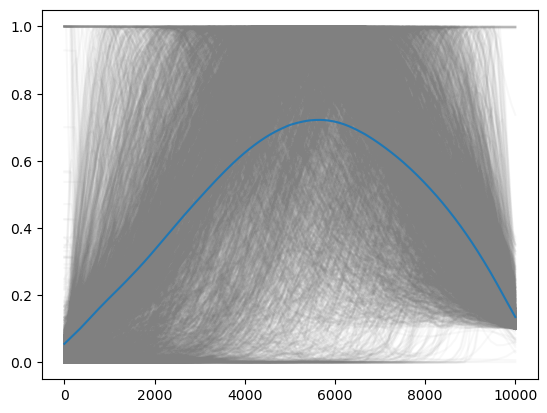

In [15]:
for s in subset:
	plt.plot(s, color = 'grey', alpha = 0.05)
plt.plot(subset.mean())

In [16]:
len(boundaries)

NameError: name 'boundaries' is not defined

In [ ]:
boundaries = np.arange(5, 9.1, 0.1)

for b in boundaries:
	bigger_than = df_interp[((df_interp.mag > b))]
	filtered = bigger_than[bigger_than.mag < b+0.1]
	
	subset = filtered.interp_momentrate.values
	for s in subset:
		plt.plot(s, color = 'grey', alpha = 0.05)
	plt.plot(subset.mean())

	plt.title(f'Events M{b:.1f} --- {b+0.1:.1f}')

	plt.show()
	plt.close()


In [134]:
boundaries = np.arange(5, 8.6, 0.1)

In [135]:
len(boundaries)

36

In [149]:
np.linspace(0, 1, 11)

array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ])

In [34]:
list(subset)

[array([0.15442526, 0.15636585, 0.15830644, ..., 0.10988415, 0.1097451 ,
        0.10960604]),
 array([0.01069854, 0.01173561, 0.01277268, ..., 0.11260049, 0.11240489,
        0.11220929])]

In [40]:
np.median(list(subset), axis = 0)

array([0.01089114, 0.01185108, 0.01281102, ..., 0.10619493, 0.10609567,
       0.105991  ])

In [22]:
df_interp_all = df_interp.copy()

In [23]:
df_interp_all

,event,dataset,mag,interp_momentrate
0,20170818_0259,scardec_opt,6.591,"[0.025571430582375584, 0.02580713208922849, 0...."
1,20170818_0259,scardec_moy,6.591,"[0.0649328959491289, 0.06495836901862619, 0.06..."
2,20110126_1542,scardec_opt,6.114,"[0.02442497978026939, 0.0246171867196723, 0.02..."
3,20110126_1542,scardec_moy,6.114,"[0.005022598858295051, 0.005007530833759215, 0..."
4,20110126_1542,sigloch_0,6.114,"[0.05504004749655065, 0.05511206329948409, 0.0..."
...,...,...,...,...
11757,20230206_1024,usgs,NaN,"[2.4688726296868274e-07, 5.827989128186977e-07..."
11758,20231202_1437,usgs,NaN,"[1.0173933482195323e-07, 2.219968359510766e-07..."
11759,19971108_1002,usgs,NaN,"[0.0011436355847583152, 0.0011974800886728725,..."
11760,20181220_1701,usgs,NaN,"[0.003668254736710576, 0.0038283515561107523, ..."


In [60]:
df_interp_all['dataset'].str.contains('usgs')

0        False
1        False
2        False
3        False
4        False
         ...  
12959     True
12960     True
12961     True
12962     True
12963     True
Name: dataset, Length: 12964, dtype: bool

In [62]:
df_interp_all[df_interp_all['dataset'].str.contains('sigloch')]

,event,dataset,mag,interp_momentrate
4,20110126_1542,sigloch_0,6.1140,"[0.05504004749655065, 0.05511206329948409, 0.0..."
13,20011012_1502,sigloch_0,6.9675,"[0.07250868016843713, 0.07261235037877496, 0.0..."
14,20011012_1502,sigloch_1,6.9675,"[0.060052349016791136, 0.06011647354943427, 0...."
15,20011012_1502,sigloch_2,6.9675,"[1.0, 0.9999970204936126, 0.9999940409872251, ..."
22,20120320_1802,sigloch_0,7.3870,"[0.0550243346751062, 0.05506360311289353, 0.05..."
...,...,...,...,...
12924,20090104_0714,sigloch_0,5.9000,"[0.06058568185870774, 0.06064107851617917, 0.0..."
12925,20090104_0714,sigloch_1,5.9000,"[0.06546361740672733, 0.06553093083438918, 0.0..."
12926,20080402_1910,sigloch_0,5.7000,"[0.1645204921512999, 0.16472039227033358, 0.16..."
12927,20071025_0835,sigloch_0,5.7000,"[0.09086361265972717, 0.0909559202949248, 0.09..."


/home/earthquakes1/software/Ubuntu/anaconda3/envs/rlc5/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/earthquakes1/software/Ubuntu/anaconda3/envs/rlc5/lib/python3.10/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


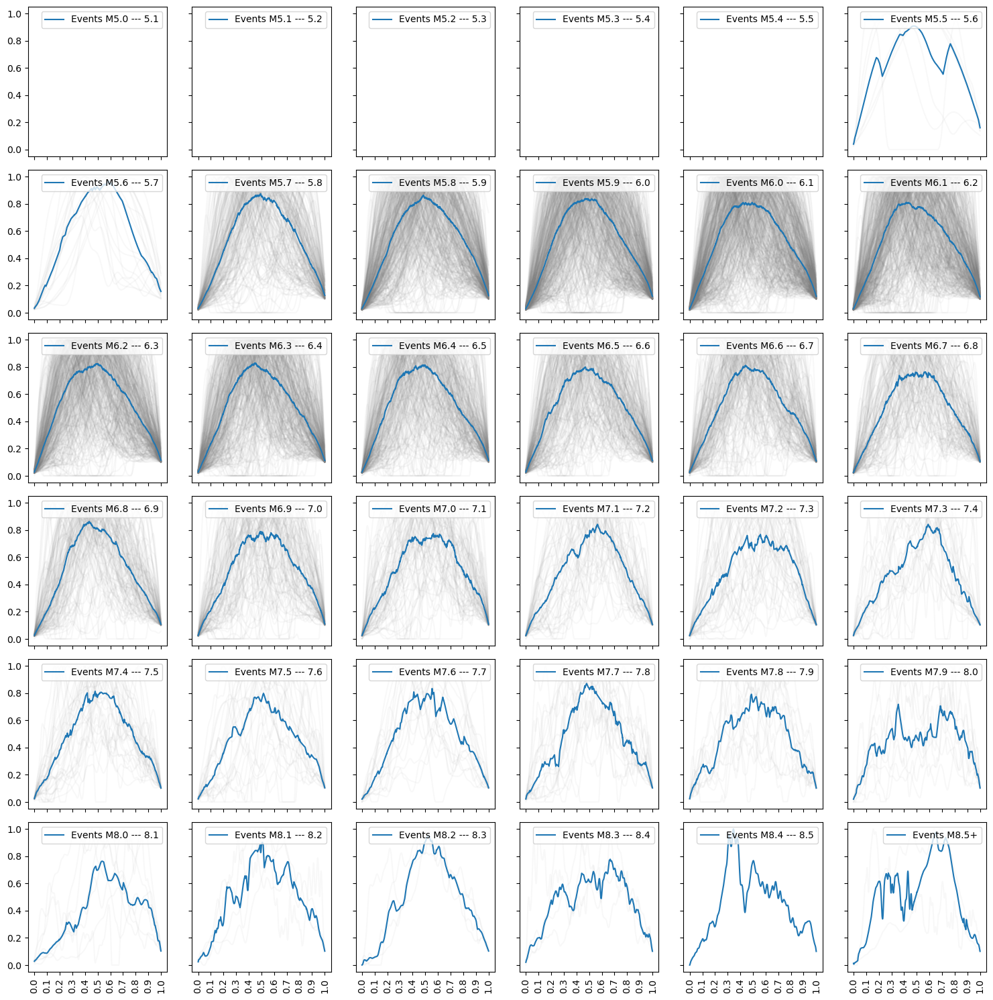

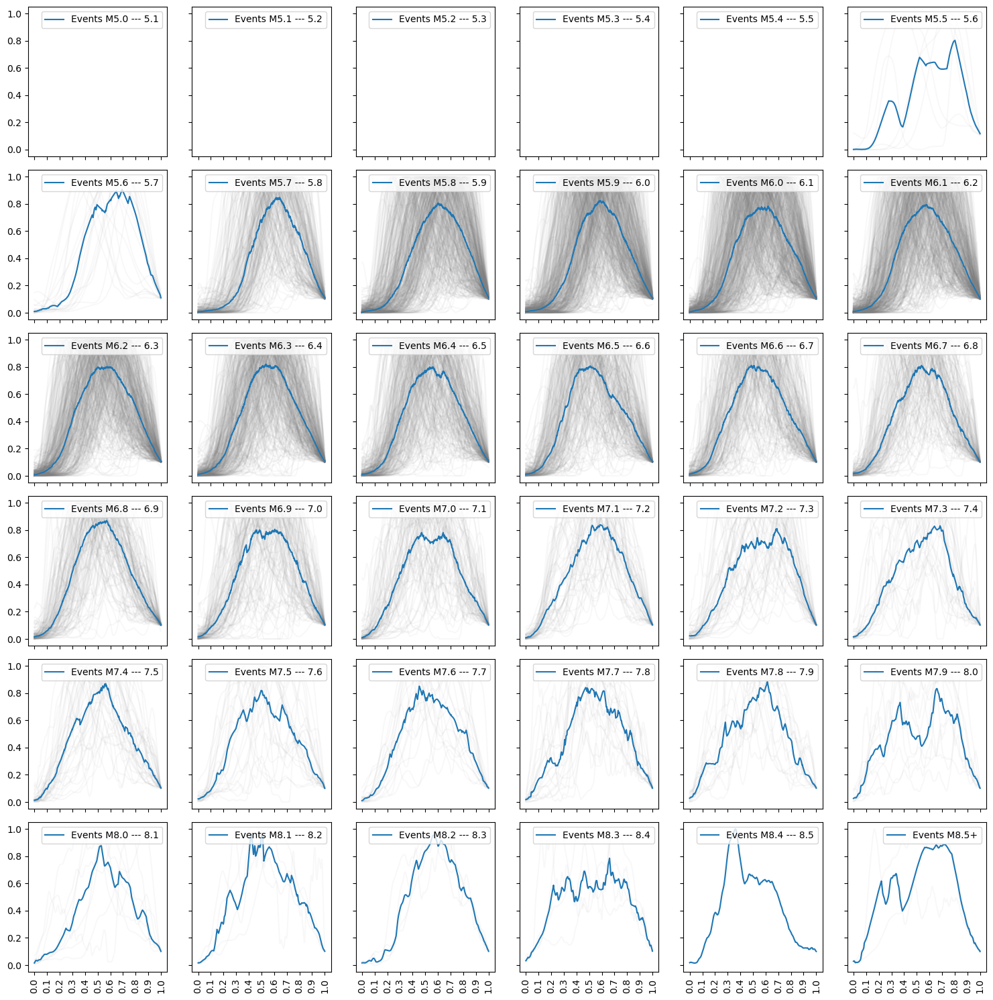

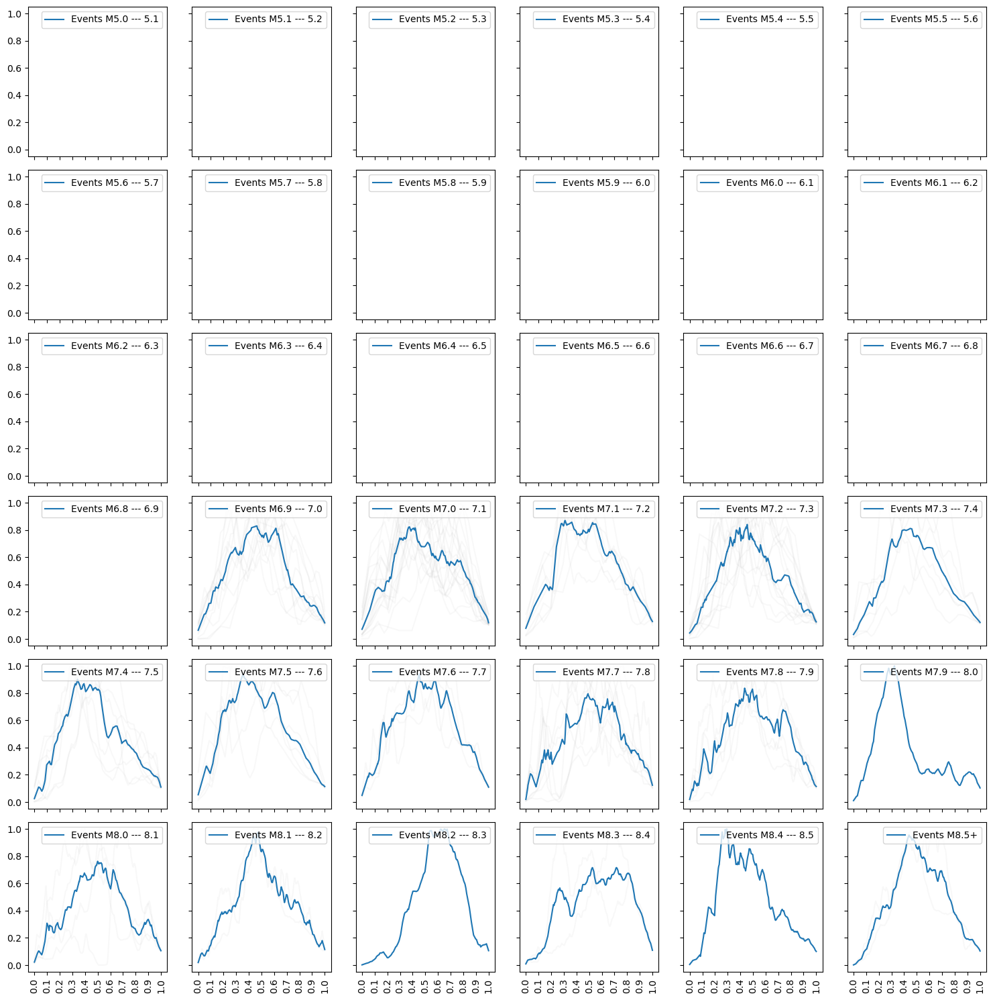

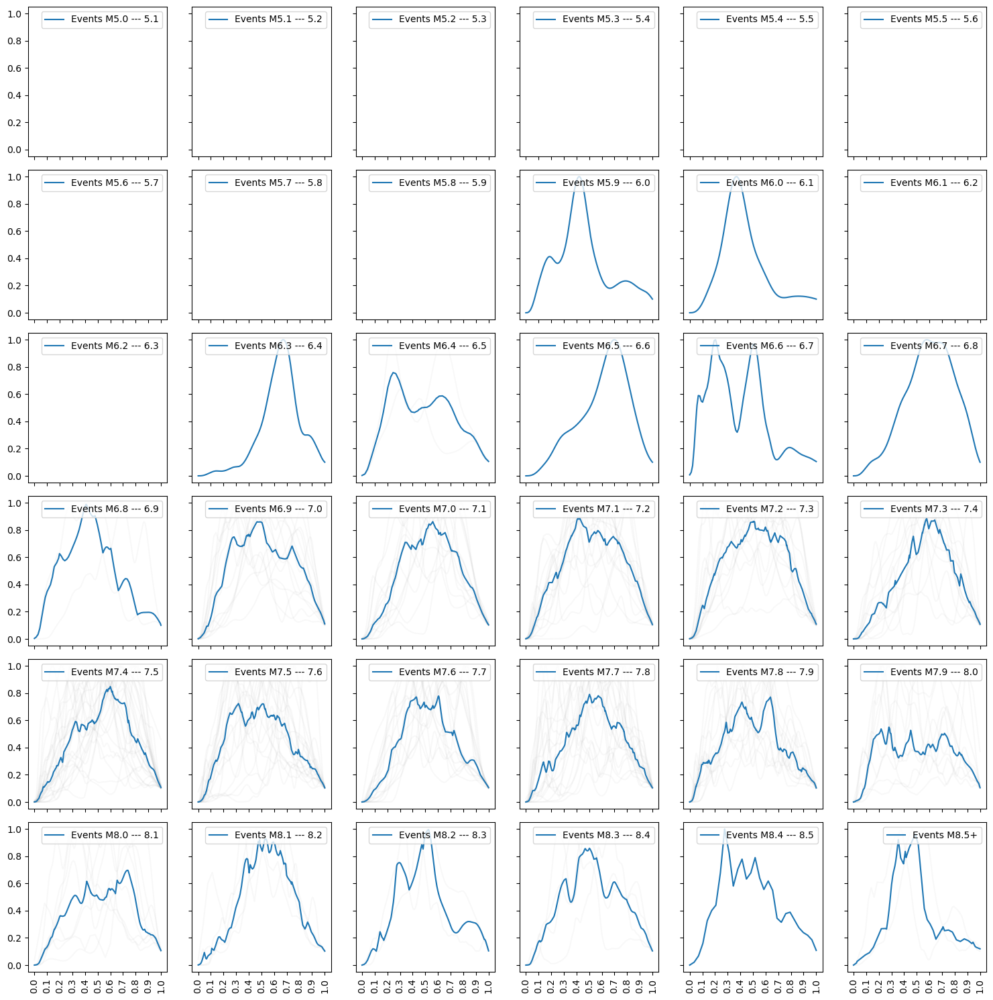

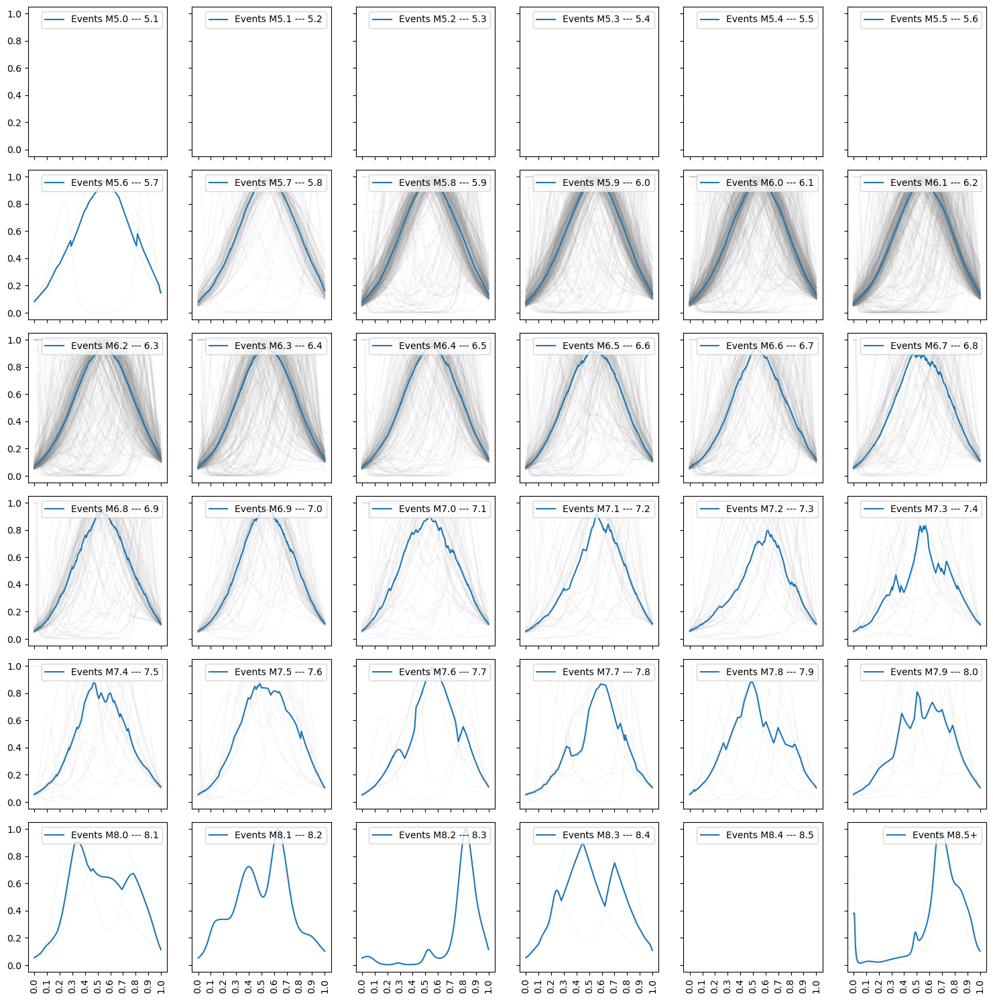

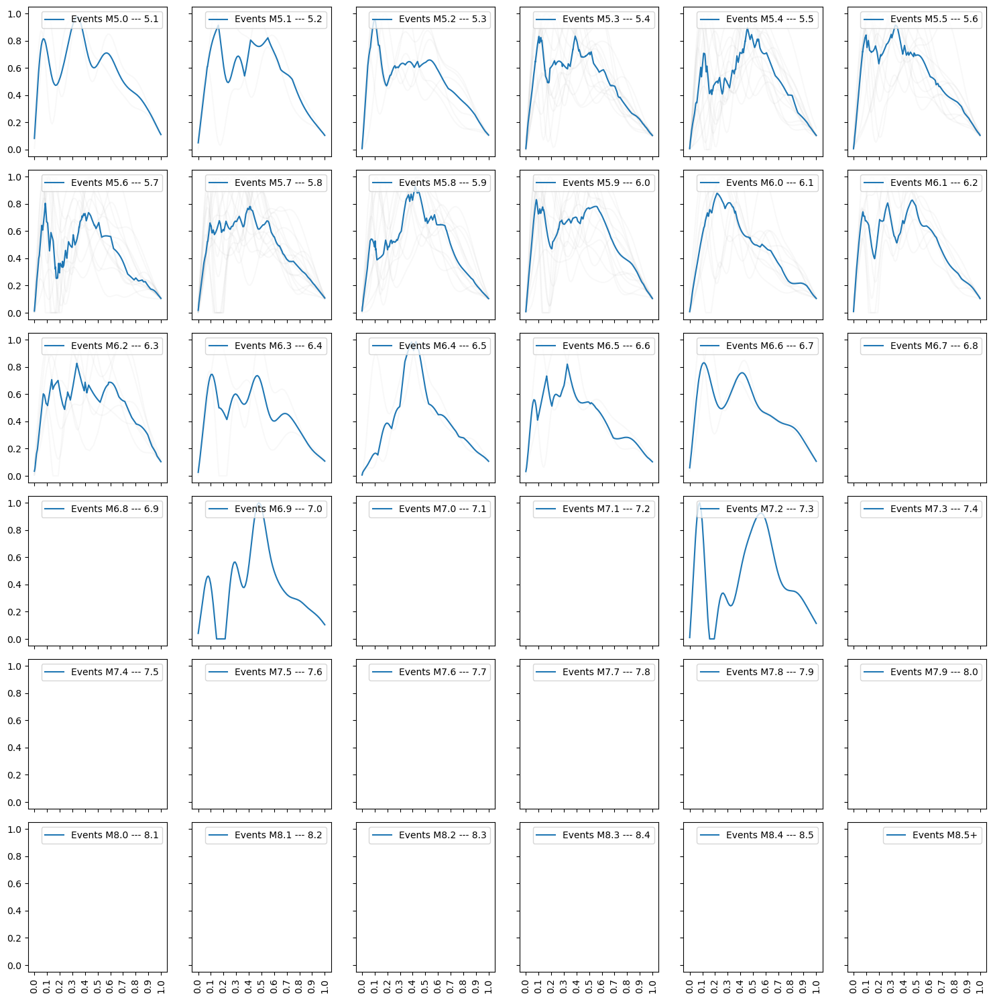

In [65]:
boundaries = np.arange(5, 8.6, 0.1)
ticks = np.arange(0, 1.1, 0.1)
ticks = list(map(lambda x: round(x, 1), ticks))
for dataset in ['scardec_opt', 'scardec_moy', 'ye', 'usgs', 'sigloch', 'isc']:
	fig, axs = plt.subplots(6, 6, figsize=(15, 15), sharex = True, sharey = True)
	df_interp = df_interp_all[df_interp_all['dataset'].str.contains(dataset)]
	for i, b in enumerate(boundaries):
		b = round(b, 1)

		ax = axs[i//6, i%6]
		bigger_than = df_interp[((df_interp.mag > b))]
		if b == 8.5:
			filtered = bigger_than
			subset = filtered.interp_momentrate.values
			for s in subset:
				ax.plot(s, color = 'grey', alpha = 0.05)
			ax.plot(np.median(list(subset), axis = 0), label = f'Events M{b:.1f}+')
		else:
			filtered = bigger_than[bigger_than.mag < b+0.1]
			subset = filtered.interp_momentrate.values
			for s in subset:
				ax.plot(s, color = 'grey', alpha = 0.05)
			ax.plot(np.median(list(subset), axis = 0), label = f'Events M{b:.1f} --- {b+0.1:.1f}')

		

		ax.set_xticks(np.linspace(0, 10000, 11), ticks, rotation = 90)
		ax.legend(loc = 'upper right')
			
	plt.tight_layout()

	plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/average_STF/median_stf_by_mag_{dataset}.png')
	plt.show()
	plt.close()


/home/earthquakes1/software/Ubuntu/anaconda3/envs/rlc6/lib/python3.12/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


5.0 0.01 0
5.1 0.1693 3
5.2 0.1155 5
5.3 0.1227 14
5.4 0.4656 16
5.5 0.3888 26
5.6 0.5122 60
5.7 0.6197 466
5.8 0.5854 1286
5.9 0.5773 1350
6.0 0.5707 1455
6.1 0.5576 1261
6.2 0.522 1048
6.3 0.5378 935
6.4 0.5526 683
6.5 0.4721 564
6.6 0.5227 498
6.7 0.5318 351
6.8 0.5327 353
6.9 0.5557 302
7.0 0.553 212
7.1 0.5375 148
7.2 0.4632 136
7.3 0.6084 73
7.4 0.5826 110
7.5 0.518 73
7.6 0.484 61
7.7 0.5321 72
7.8 0.6123 51
7.9 0.3633 29
8.0 0.5514 27
8.1 0.4943 16
8.2 0.5419 12
8.3 0.4599 14
8.4 0.3604 3
8.5 0.01 0
8.6 0.1707 3
8.7 0.6516 3
8.8 0.01 0
8.9 0.01 0
9.0 0.6989 3


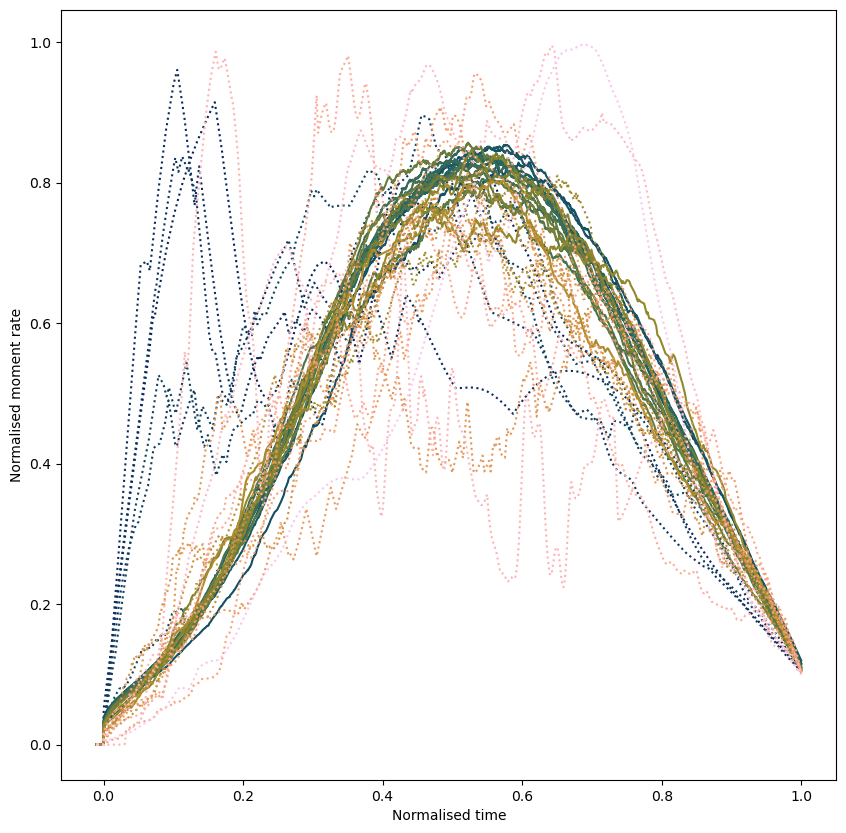

In [20]:
interval = 0.1
boundaries = np.arange(5, 9.1, interval)

colors = cmc.batlow((np.linspace(0, len(boundaries), len(boundaries)+1)/len(boundaries)))
max_len = 0
peak_all = []
peak_more_than_100 = []

fig, axs = plt.subplots(1, 1, figsize=(10, 10))
for i, b in enumerate(boundaries):
	bigger_than = df_interp[((df_interp.mag > b))]
	filtered = bigger_than[bigger_than.mag < b+interval]
	max_len = max(max_len, len(filtered))
	subset = filtered.interp_momentrate.values
	if len(subset) < 100:
		marker = ':'
		alpha = 1
	else:
		marker = '-'
		alpha = 1
	# if np.isnan(np.nanmedian(list(subset), axis = 0))[0] == True:
	# 	continue
	try:
		y_med = np.nanmedian(list(subset), axis = 0)
		y = np.zeros(10100)
		y[100:] = y_med
		x = np.arange(-100, 10000, 1)
		plt.plot(np.arange(-0.01, 1, 0.0001), y, label = f'{b:.1f}---{b+interval:.1f} (n={len(subset)})', color = colors[i], linestyle = marker, alpha = alpha)
		print(np.round(b, 1), np.argmax(y)/10000, len(subset))
		peak_all.append(np.argmax(y)/10000)
		if len(subset) > 100:
			peak_more_than_100.append(np.argmax(np.nanmedian(list(subset), axis = 0))/10000)
	except ValueError:
		continue

# sm = plt.cm.ScalarMappable(cmap=cmc.batlow, norm=plt.Normalize(vmin=boundaries.min(), vmax=boundaries.max()))
# cbar = plt.colorbar(sm, ax = ax, ticks=np.linspace(boundaries.min(), boundaries.max(), num=11))
# cbar.ax.set_yticklabels([f'{b:.1f}' for b in np.linspace(boundaries.min(), boundaries.max(), num=11)])
# cbar.set_label('Magnitude')
sm = plt.cm.ScalarMappable(cmap=cmc.batlow, norm=plt.Normalize(vmin=boundaries.min(), vmax=boundaries.max()))
cbar = plt.colorbar(sm, ax=ax, ticks=np.linspace(boundaries.min(), boundaries.max(), num=11))
cbar.ax.set_yticklabels([f'{b:.1f}' for b in np.linspace(boundaries.min(), boundaries.max(), num=11)])
cbar.set_label('Magnitude')


#plt.plot(np.arange(0, 1, 0.0001), np.nanmedian(list(df_interp.interp_momentrate.values), axis = 0), label = f'all events', color = 'k')


	#plt.title(f'Events M{b:.1f} --- {b+0.1:.1f}')

	#plt.show()
#plt.legend()
plt.ylabel('Normalised moment rate')
plt.xlabel('Normalised time')
plt.savefig('/home/earthquakes1/homes/Rebecca/phd/stf/figures/average_STF/median_only_every_01_nolegend_with_overall_median.png')



(array([1., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 1., 1., 0., 0., 0., 0., 1., 1., 0., 0., 2., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 2., 0., 1., 1., 0., 0., 0., 0., 0., 0., 0.,
        1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 1., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.]),
 array([0.4532  , 0.454765, 0.45633 , 0.457895, 0.45946 , 0.461025,
        0.46259 , 0.464155, 0.46572 , 0.467285, 0.46885 , 0.470415,
        0.47198 , 0.473545, 0.47511 , 0.476675, 0.47824 , 0.479805,
        0.48137 , 0.482935, 0.4845  , 0.486065, 0.48763 , 0.489195,
        0.49076 , 0.492325, 0.49389 , 0.495455, 0.49702 , 0.498585,
        0.50015 , 0.501715, 0.50328 , 0.504845, 0.50641 , 0.507975,
        0.50954 , 0.511105, 0.51267 , 0.514235, 0.5158  , 0.517365,
        0.51893 , 0.520495, 0.52206 , 0.523625, 0.52519 , 0.526755,
      

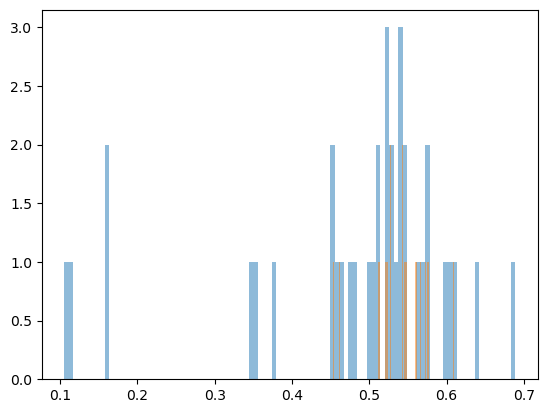

In [40]:
plt.hist(peak_all, bins = 100, alpha = 0.5, label = 'All')
plt.hist(peak_more_than_100, bins = 100, alpha = 0.5, label = 'More than 100 events')

In [41]:
min(peak_more_than_100)

0.4532

In [42]:
max(peak_more_than_100)

0.6097

In [43]:
np.mean(peak_more_than_100)

0.5355529411764706

In [44]:
np.median(peak_more_than_100)

0.5426

In [45]:
np.std(peak_more_than_100)

0.03771812043297677

In [77]:
np.cumsum(np.nanmedian(list(subset), axis = 0))

array([5.02460088e-03, 1.00948353e-02, 1.52107032e-02, ...,
       4.26940812e+03, 4.26951026e+03, 4.26961227e+03])

2
3
6
15
19
47
95
584
1595
1577
1581
1314
1084
955
691
570
498
354
353
306
238
170
160
92
135
89
73
86
64
41
32
18
14
17
4
0
4
5
0
0
4


/home/earthquakes1/software/Ubuntu/anaconda3/envs/rlc5/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/earthquakes1/software/Ubuntu/anaconda3/envs/rlc5/lib/python3.10/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


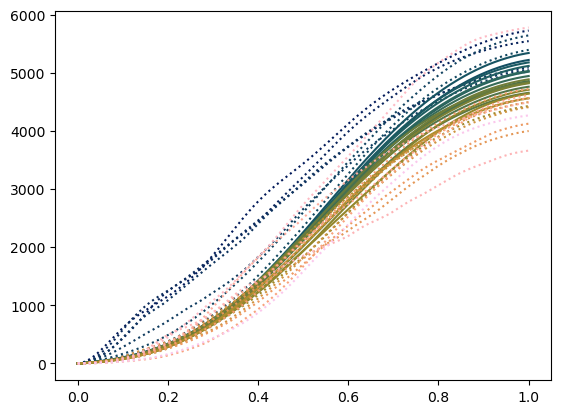

In [ ]:
interval = 0.1
boundaries = np.arange(5, 9.1, interval)

colors = cmc.batlow((np.linspace(0, len(boundaries), len(boundaries)+1)/len(boundaries)))
max_len = 0
for i, b in enumerate(boundaries):
	bigger_than = df_interp[((df_interp.mag > b))]
	filtered = bigger_than[bigger_than.mag < b+interval]
	max_len = max(max_len, len(filtered))
	subset = filtered.interp_momentrate.values
	print(len(subset))
	if len(subset) < 100:
		marker = ':'
	else:
		marker = '-'

	cumsum = np.cumsum(np.nanmedian(list(subset), axis = 0))
	if len(cumsum) > 1:
		plt.plot(np.linspace(0, 1, 10000), cumsum, label = f'{b:.1f}---{b+interval:.1f} (n={len(subset)})', color = colors[i], linestyle = marker)


	#plt.title(f'Events M{b:.1f} --- {b+0.1:.1f}')

	#plt.show()
#plt.legend()

#plt.savefig('/home/earthquakes1/homes/Rebecca/phd/stf/figures/average_STF/median_only_every_01_nolegend.png')



In [108]:
df_interp

,event,dataset,mag,interp_momentrate
0,20170818_0259,scardec_opt,6.591,"[0.025571430582375584, 0.02580713208922849, 0...."
1,20170818_0259,scardec_moy,6.591,"[0.0649328959491289, 0.06495836901862619, 0.06..."
2,20110126_1542,scardec_opt,6.114,"[0.02442497978026939, 0.0246171867196723, 0.02..."
3,20110126_1542,scardec_moy,6.114,"[0.005022598858295051, 0.005007530833759215, 0..."
4,20110126_1542,sigloch_0,6.114,"[0.05504004749655065, 0.05511206329948409, 0.0..."
...,...,...,...,...
12959,20230206_1024,usgs,NaN,"[2.4688726296868274e-07, 5.827989128186977e-07..."
12960,20231202_1437,usgs,NaN,"[1.0173933482195323e-07, 2.219968359510766e-07..."
12961,19971108_1002,usgs,NaN,"[0.0011436355847583152, 0.0011974800886728725,..."
12962,20181220_1701,usgs,NaN,"[0.003668254736710576, 0.0038283515561107523, ..."


25
56
584
1595
1577
1581
1314
1084
955
691
570
498
354
353
306
238
170
160
92
135
89
73
86
64
41
32
18
14
17
4
0
false
4
5
0
false
0
false
4


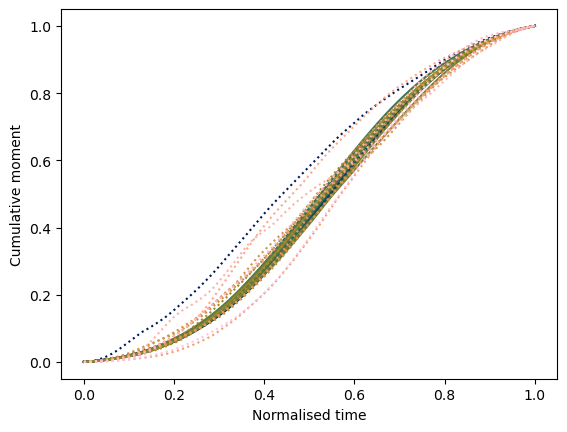

In [134]:
interval = 0.1
boundaries = np.arange(5.5, 9.1, interval)

colors = cmc.batlow((np.linspace(0, len(boundaries), len(boundaries)+1)/len(boundaries)))
max_len = 0
for i, b in enumerate(boundaries):
	bigger_than = df_interp[((df_interp.mag > b))]
	filtered = bigger_than[bigger_than.mag < b+interval]
	max_len = max(max_len, len(filtered))
	subset = filtered.interp_momentrate.values
	print(len(subset))
	if len(subset) < 100:
		marker = ':'
	else:
		marker = '-'

	if type(np.nanmedian(list(subset), axis = 0)) is np.ndarray:
		moment = scipy.integrate.cumtrapz(np.nanmedian(list(subset), axis = 0))[-1]
		#if np.isnan(np.nanmedian(list(subset), axis = 0)) is not True:
		cumsum = scipy.integrate.cumtrapz(np.nanmedian(list(subset), axis = 0))#, np.linspace(0, 1, 10000))
		plt.plot(np.linspace(0, 1, 9999), cumsum/moment, label = f'{b:.1f}---{b+interval:.1f} (n={len(subset)})', color = colors[i], linestyle = marker)
	else:
		print('false')

plt.ylabel('Cumulative moment')
plt.xlabel('Normalised time')

	#plt.title(f'Events M{b:.1f} --- {b+0.1:.1f}')

#plt.show()
#plt.legend()

plt.savefig('/home/earthquakes1/homes/Rebecca/phd/stf/figures/average_STF/cumulative_moment_for_median_stf.png')



25
56
584
1595
1577
1581
1314
1084
955
691
570
498
354
353
306
238
170
160
92
135
89
73
86
64
41
32
18
14
17
4
0
false
4
5
0
false
0
false
4


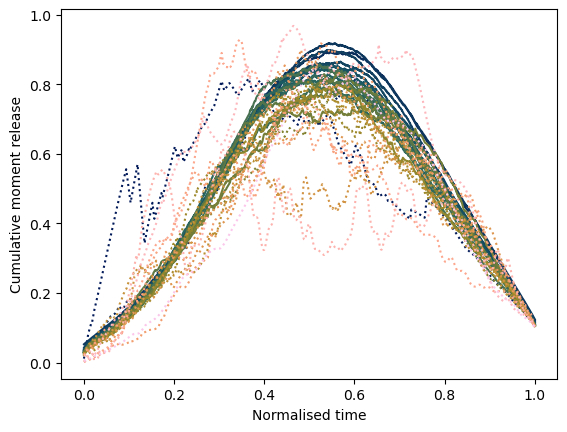

In [116]:
interval = 0.1
boundaries = np.arange(5.5, 9.1, interval)

colors = cmc.batlow((np.linspace(0, len(boundaries), len(boundaries)+1)/len(boundaries)))
max_len = 0
for i, b in enumerate(boundaries):
	bigger_than = df_interp[((df_interp.mag > b))]
	filtered = bigger_than[bigger_than.mag < b+interval]
	max_len = max(max_len, len(filtered))
	subset = filtered.interp_momentrate.values
	print(len(subset))
	if len(subset) < 100:
		marker = ':'
	else:
		marker = '-'

	if type(np.nanmedian(list(subset), axis = 0)) is np.ndarray:
		#if np.isnan(np.nanmedian(list(subset), axis = 0)) is not True:
		cumsum = np.nanmedian(list(subset), axis = 0)#, np.linspace(0, 1, 10000))
		plt.plot(np.linspace(0, 1, 10000), cumsum, label = f'{b:.1f}---{b+interval:.1f} (n={len(subset)})', color = colors[i], linestyle = marker)
	else:
		print('false')

plt.ylabel('Cumulative moment release')
plt.xlabel('Normalised time')

	#plt.title(f'Events M{b:.1f} --- {b+0.1:.1f}')

plt.show()
#plt.legend()

#plt.savefig('/home/earthquakes1/homes/Rebecca/phd/stf/figures/average_STF/median_only_every_01_nolegend.png')



25
56
584
1595
1577
1581
1314
1084
955
691
570
498
354
353
306
238
170
160
92
135
89
73
86
64
41
32
18
14
17
4
0
false
4
5
0
false
0
false
4


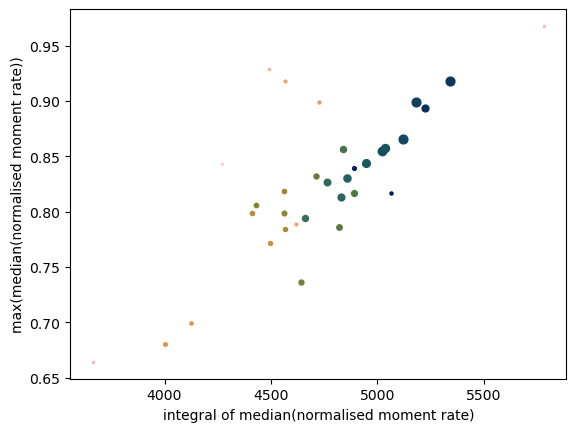

In [135]:
interval = 0.1
boundaries = np.arange(5.5, 9.1, interval)

colors = cmc.batlow((np.linspace(0, len(boundaries), len(boundaries)+1)/len(boundaries)))
max_len = 0
for i, b in enumerate(boundaries):
	bigger_than = df_interp[((df_interp.mag > b))]
	filtered = bigger_than[bigger_than.mag < b+interval]
	max_len = max(max_len, len(filtered))
	subset = filtered.interp_momentrate.values
	print(len(subset))
	if len(subset) < 100:
		marker = ':'
	else:
		marker = '-'

	if type(np.nanmedian(list(subset), axis = 0)) is np.ndarray:
		moment = scipy.integrate.cumtrapz(np.nanmedian(list(subset), axis = 0))[-1]
		#if np.isnan(np.nanmedian(list(subset), axis = 0)) is not True:
		#cumsum = scipy.integrate.cumtrapz(np.nanmedian(list(subset), axis = 0))#, np.linspace(0, 1, 10000))
		plt.scatter(moment, max(np.nanmedian(list(subset), axis = 0)), label = f'{b:.1f}---{b+interval:.1f} (n={len(subset)})', color = colors[i], s = np.sqrt(len(subset)))#, linestyle = marker)
	else:
		print('false')

plt.ylabel('max(median(normalised moment rate))')
plt.xlabel('integral of median(normalised moment rate)')

	#plt.title(f'Events M{b:.1f} --- {b+0.1:.1f}')

#plt.show()
#plt.legend()

plt.savefig('/home/earthquakes1/homes/Rebecca/phd/stf/figures/average_STF/peak_mr_vs_integral_of_mr.png')



In [123]:
subset

array([array([0.02861027, 0.02875576, 0.02890125, ..., 0.18984658, 0.18955574,
              0.1892649 ])                                                    ,
       array([0.00249939, 0.00249553, 0.00249166, ..., 0.1243579 , 0.12395533,
              0.12355276])                                                    ,
       array([0.03837141, 0.03848262, 0.03859383, ..., 0.18155049, 0.18127032,
              0.18099015])                                                    ,
       array([0.00053624, 0.00053415, 0.00053207, ..., 0.11345617, 0.11323612,
              0.11301606])                                                    ,
       array([0.0273875 , 0.02795875, 0.02853   , ..., 0.14182532, 0.14119384,
              0.14056237])                                                    ,
       array([0.12244574, 0.12240873, 0.12237172, ..., 0.12908484, 0.12866077,
              0.12823669])                                                    ,
       array([0.0435288 , 0.04394893, 0.044369

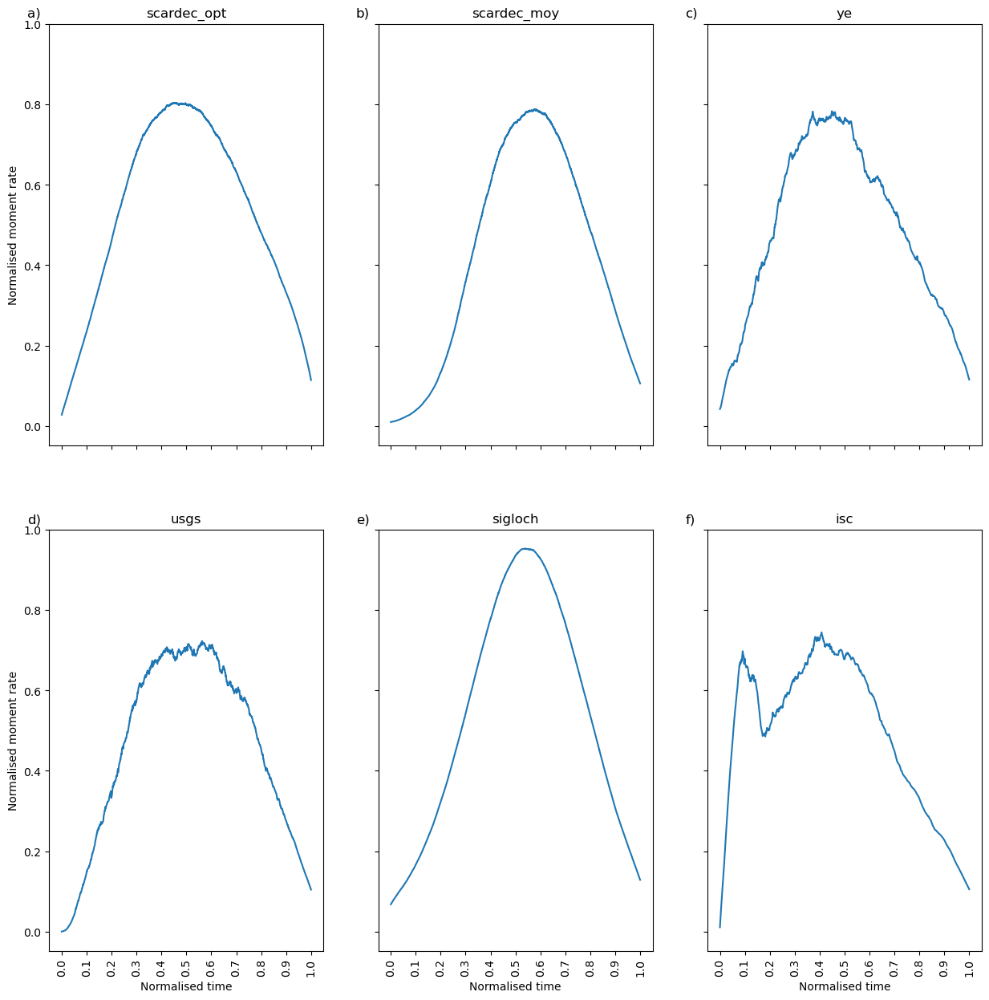

In [56]:
ticks = np.arange(0, 1.1, 0.1)
ticks = list(map(lambda x: round(x, 1), ticks))

fig, axs = plt.subplots(2, 3, figsize=(15, 15), sharex = True, sharey = True)

for i, dataset in enumerate(['scardec_opt', 'scardec_moy', 'ye', 'usgs', 'sigloch', 'isc']):
	df_interp = df_interp_all[df_interp_all['dataset'].str.contains(dataset)]

	ax = axs[i//3, i%3]
	subset = df_interp.interp_momentrate.values
	# for s in subset:
	# 	ax.plot(s, color = 'grey', alpha = 0.05)
	ax.plot(np.median(list(subset), axis = 0), label = f'Events {dataset}')
	ax.set_title(f'{dataset}')

	ax.set_xticks(np.linspace(0, 10000, 11), ticks, rotation = 90)
	#ax.legend(loc = 'upper right')

	if i%3 == 0:
		ax.set_ylabel('Normalised moment rate')
	if i//3 == 1:
		ax.set_xlabel('Normalised time')		
import matplotlib.transforms as mtransforms
trans = mtransforms.ScaledTranslation(-20 / 72, 4 / 72, fig.dpi_scale_trans)
axs[0][0].text(0.0, 1.0, 'a)', transform=axs[0][0].transAxes + trans,
				fontsize='12', va='bottom')
axs[0][1].text(0.0, 1.0, 'b)', transform=axs[0][1].transAxes + trans,
				fontsize='12', va='bottom')
axs[0][2].text(0.0, 1.0, 'c)', transform=axs[0][2].transAxes + trans,
				fontsize='12', va='bottom')
axs[1][0].text(0.0, 1.0, 'd)', transform=axs[1][0].transAxes + trans,
				fontsize='12', va='bottom')
axs[1][1].text(0.0, 1.0, 'e)', transform=axs[1][1].transAxes + trans,
				fontsize='12', va='bottom')
axs[1][2].text(0.0, 1.0, 'f)', transform=axs[1][2].transAxes + trans,
				fontsize='12', va='bottom')

plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/average_STF/median_stf_by_dataset.png', bbox_inches='tight')
plt.show()
	#plt.close()


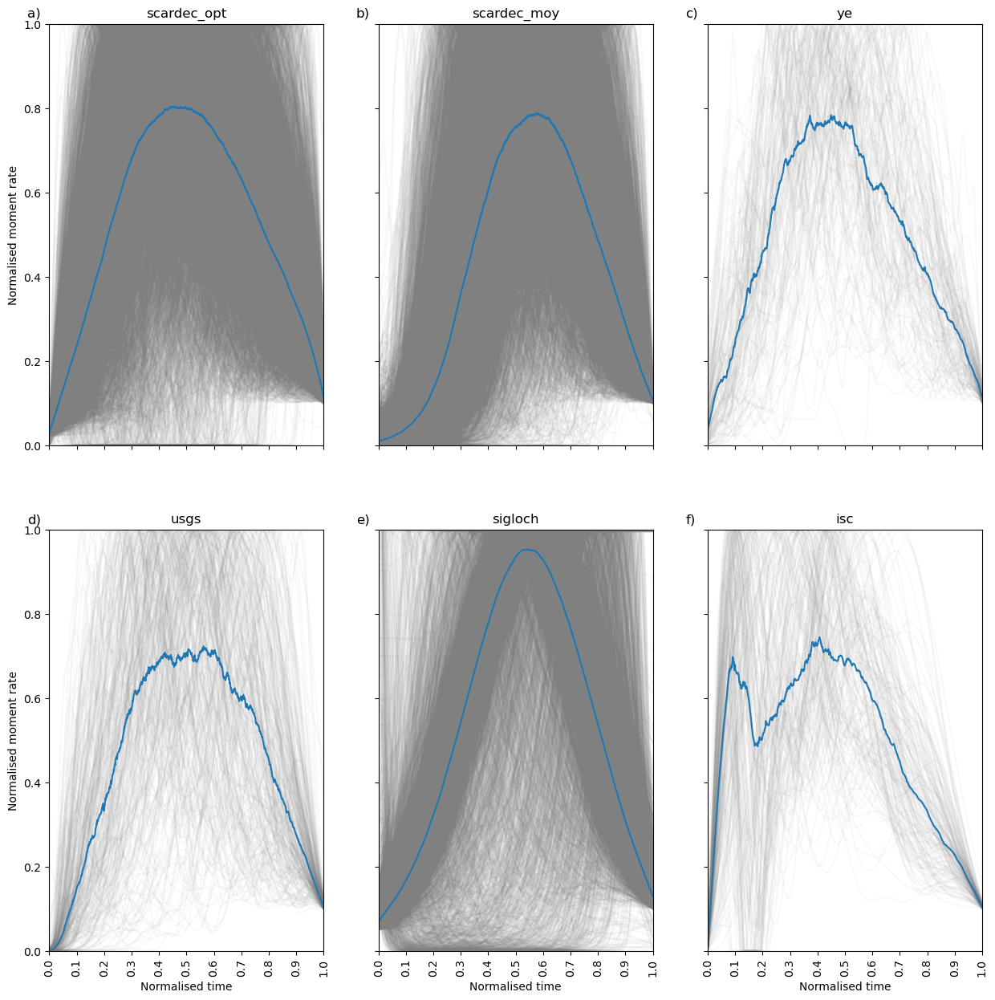

In [38]:
ticks = np.arange(0, 1.1, 0.1)
ticks = list(map(lambda x: round(x, 1), ticks))

fig, axs = plt.subplots(2, 3, figsize=(15, 15), sharex = True, sharey = True)

for i, dataset in enumerate(['scardec_opt', 'scardec_moy', 'ye', 'usgs', 'sigloch', 'isc']):
	df_interp = df_interp_all[df_interp_all['dataset'].str.contains(dataset)]

	ax = axs[i//3, i%3]
	subset = df_interp.interp_momentrate.values
	for s in subset:
		ax.plot(s, color = 'grey', alpha = 0.05)
	ax.plot(np.median(list(subset), axis = 0), label = f'Events {dataset}')
	ax.set_title(f'{dataset}')

	ax.set_xticks(np.linspace(0, 10000, 11), ticks, rotation = 90)
	ax.set_ylim(0, 1)
	ax.set_xlim(0, 10000)
	#ax.legend(loc = 'upper right')

	if i%3 == 0:
		ax.set_ylabel('Normalised moment rate')
	if i//3 == 1:
		ax.set_xlabel('Normalised time')

		# Add figure panel labels

import matplotlib.transforms as mtransforms
trans = mtransforms.ScaledTranslation(-20 / 72, 4 / 72, fig.dpi_scale_trans)
axs[0][0].text(0.0, 1.0, 'a)', transform=axs[0][0].transAxes + trans,
				fontsize='12', va='bottom')
axs[0][1].text(0.0, 1.0, 'b)', transform=axs[0][1].transAxes + trans,
				fontsize='12', va='bottom')
axs[0][2].text(0.0, 1.0, 'c)', transform=axs[0][2].transAxes + trans,
				fontsize='12', va='bottom')
axs[1][0].text(0.0, 1.0, 'd)', transform=axs[1][0].transAxes + trans,
				fontsize='12', va='bottom')
axs[1][1].text(0.0, 1.0, 'e)', transform=axs[1][1].transAxes + trans,
				fontsize='12', va='bottom')
axs[1][2].text(0.0, 1.0, 'f)', transform=axs[1][2].transAxes + trans,
				fontsize='12', va='bottom')
#plt.tight_layout()

plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/average_STF/median_stf_by_dataset_and_all_data.png', bbox_inches='tight')
plt.show()
	#plt.close()


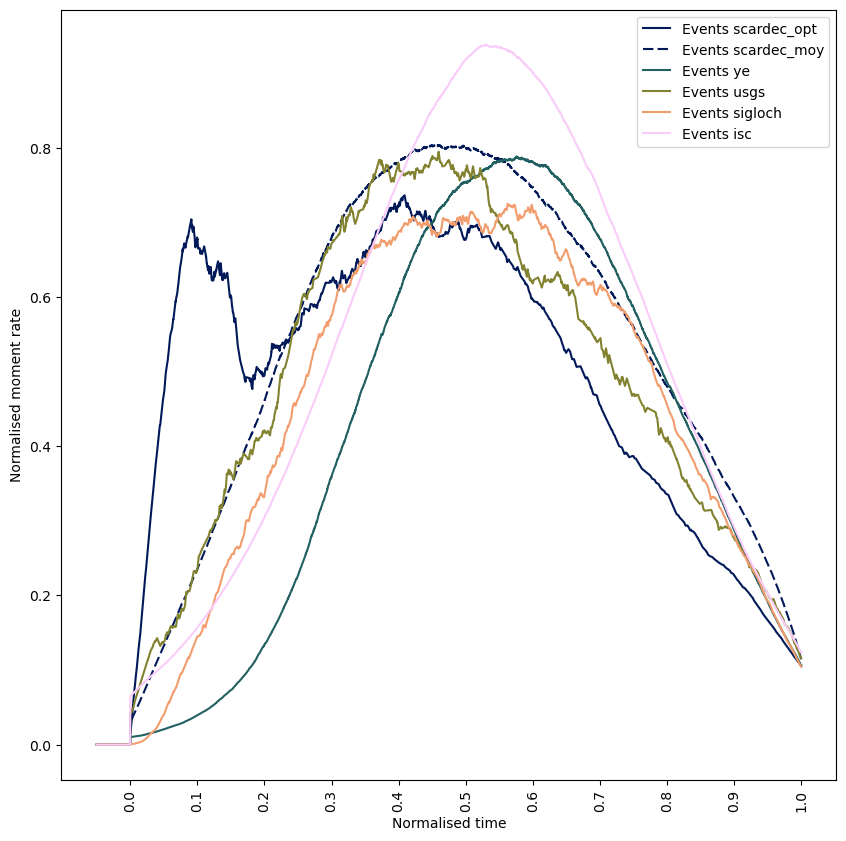

In [35]:
ticks = np.arange(0, 1.1, 0.1)
ticks = list(map(lambda x: round(x, 1), ticks))

fig, axs = plt.subplots(1, 1, figsize=(10, 10), sharex = True, sharey = True)

colors = cmc.batlow(np.linspace(0, 1, 5))

for i, dataset in enumerate(['scardec_opt', 'scardec_moy', 'ye', 'usgs', 'sigloch', 'isc']):
	df_interp = df_interp_all[df_interp_all['dataset'].str.contains(dataset)]
	y_med = np.nanmedian(list(subset), axis = 0)
	#x = np.arange(0, 10500, 1)
	y = np.zeros(10500)
	y[500:] = y_med
	x = np.arange(-500, 10000, 1)
	ax = axs
	subset = df_interp.interp_momentrate.values
	# for s in subset:
	# 	ax.plot(s, color = 'grey', alpha = 0.05)
	if i > 1 : 
		ax.plot(y, label = f'Events {dataset}', color = colors[i-1], linestyle = 'solid')
	elif i == 1:
		ax.plot(y, label = f'Events {dataset}', color = colors[i-1], linestyle = (0, (5,2)))
	else:
		ax.plot(y, label = f'Events {dataset}', color = colors[i], linestyle = 'solid')
	#ax.set_title(f'{dataset}')

ax.set_xticks([500, 1500, 2500, 3500, 4500, 5500, 6500, 7500, 8500, 9500, 10500], ticks, rotation = 90)
#ax.legend(loc = 'upper right')

ax.set_ylabel('Normalised moment rate')
ax.set_xlabel('Normalised time')		

plt.legend()

plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/average_STF/median_stf_by_dataset_all_on_one.png', bbox_inches='tight', dpi=300)
plt.show()
	#plt.close()


In [31]:
ticks

[0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

In [22]:
for i, dataset in enumerate(['scardec_opt', 'scardec_moy', 'ye', 'usgs', 'sigloch', 'isc']):
	df_interp = df_interp_all[df_interp_all['dataset'].str.contains(dataset)]
	median_stf = np.median(list(subset), axis = 0)
	subset = df_interp.interp_momentrate.values
	print(dataset)
	print(np.argmax(median_stf))
	

scardec_opt
4073
scardec_moy
4494
ye
5761
usgs
4497
sigloch
5622
isc
5399


In [20]:
np.mean(np.median(list(subset), axis = 0))

0.4959666807054781